#Practical Task 1 of T20

In [1]:
# Import all libraries for calculation
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

In [2]:
# for visualisation
import graphviz
import matplotlib.pyplot as plt
from sklearn.tree import export_graphviz
from IPython.display import Image  
from subprocess import call

In [3]:
# Load data
titanic_df = pd.read_csv("titanic.csv")
titanic_df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


In [4]:
titanic_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   PassengerId  891 non-null    int64  
 1   Survived     891 non-null    int64  
 2   Pclass       891 non-null    int64  
 3   Name         891 non-null    object 
 4   Sex          891 non-null    object 
 5   Age          714 non-null    float64
 6   SibSp        891 non-null    int64  
 7   Parch        891 non-null    int64  
 8   Ticket       891 non-null    object 
 9   Fare         891 non-null    float64
 10  Cabin        204 non-null    object 
 11  Embarked     889 non-null    object 
dtypes: float64(2), int64(5), object(5)
memory usage: 83.7+ KB


In [5]:
# You can also drop whichever other columns you'd like here
titanic_df.drop("Cabin", axis=1, inplace=True)
# PassengerId, Name and Ticket are irrelavant also, so drop them as well
titanic_df.drop("PassengerId", axis=1, inplace=True)
titanic_df.drop("Name", axis=1, inplace=True)
titanic_df.drop("Ticket", axis=1, inplace=True)

### One-Hot Encoding
One-hot encoding is a technique used to ensure that categorical variables are better represented in the machine. Let's take a look at the "Sex" column

In [6]:
titanic_df["Sex"].unique()

array(['male', 'female'], dtype=object)

Machine Learning classifiers don't know how to handle strings. As a result, you need to convert it into a categorical representation. There are two main ways to go about this:

Label Encoding: Assigning, for example, 0 for "male" and 1 for "female". The problem here is it intrinsically makes one category "larger than" the other category.

One-hot encoding: Assigning, for example, [1, 0] for "male" and [0, 1] for female. In this case, you have an array of size (n_categories,) and you represent a 1 in the correct index, and 0 elsewhere. In Pandas, this would show as extra columns. For example, rather than having a "Sex" column, it would be a "Sex_male" and "Sex_female" column. Then, if the person is male, it would simply show as a 1 in the "Sex_male" column and a 0 in the "Sex_female" column.

There is a nice and easy method that does this in pandas: get_dummies()

In [7]:
titanic_df = pd.get_dummies(titanic_df, prefix="Sex", columns=["Sex"])
#titanic_df.head()
titanic_df.describe()

,Survived,Pclass,Age,SibSp,Parch,Fare
count,891.000000,891.000000,714.000000,891.000000,891.000000,891.000000
mean,0.383838,2.308642,29.699118,0.523008,0.381594,32.204208
std,0.486592,0.836071,14.526497,1.102743,0.806057,49.693429
min,0.000000,1.000000,0.420000,0.000000,0.000000,0.000000
25%,0.000000,2.000000,20.125000,0.000000,0.000000,7.910400
50%,0.000000,3.000000,28.000000,0.000000,0.000000,14.454200
75%,1.000000,3.000000,38.000000,1.000000,0.000000,31.000000
max,1.000000,3.000000,80.000000,8.000000,6.000000,512.329200


Now, we do the same to the "Embarked" column.

In [8]:
titanic_df = pd.get_dummies(titanic_df, prefix="Embarked", columns=["Embarked"])
titanic_df.head()

,Survived,Pclass,Age,SibSp,Parch,Fare,Sex_female,Sex_male,Embarked_C,Embarked_Q,Embarked_S
0,0,3,22.0,1,0,7.2500,False,True,False,False,True
1,1,1,38.0,1,0,71.2833,True,False,True,False,False
2,1,3,26.0,0,0,7.9250,True,False,False,False,True
3,1,1,35.0,1,0,53.1000,True,False,False,False,True
4,0,3,35.0,0,0,8.0500,False,True,False,False,True


<Axes: >

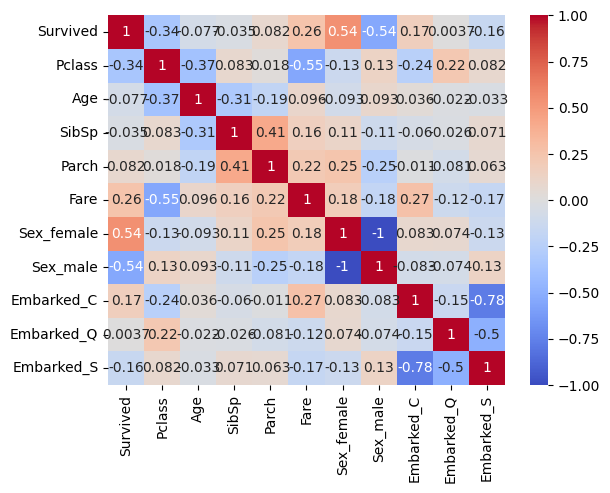

In [9]:
# Study correlation
sns.heatmap(titanic_df.corr(), annot=True, cmap='coolwarm')

# Initial Analysis
Survived will be the target result for prediction, so it will be used as y
Sex_female and Sex_male are mutual exclusive, so select only one and drop another.

In [10]:
# Remove duplicate column
titanic_df.drop("Sex_female", axis=1, inplace=True)

X = titanic_df.drop('Survived', axis=1)
y = titanic_df['Survived']

In [11]:

# Set a constant random seed
rseed = 8964
# Split the full data set into training data set and test data set 
X_train_full, X_test, y_train_full, y_test = train_test_split(X, 
                y, test_size=0.2, random_state=rseed)

print(f'X_train_full:{X_train_full.shape}')
print(f'y_train_full:{y_train_full.shape}')
print(f'X_test:{X_test.shape}')
print(f'y_test:{y_test.shape}')

# Split the training data set into training set and development set
X_train, X_dev, y_train, y_dev = train_test_split(X_train_full, 
                y_train_full, test_size=0.2, random_state=rseed)

print(f'X_train:{X_train.shape}')
print(f'y_train:{y_train.shape}')
print(f'X_dev:{X_dev.shape}')
print(f'y_dev:{y_dev.shape}')

X_train_full:(712, 9)
y_train_full:(712,)
X_test:(179, 9)
y_test:(179,)
X_train:(569, 9)
y_train:(569,)
X_dev:(143, 9)
y_dev:(143,)


In [12]:
# training a model without pruning for training set
unpruned_test = DecisionTreeClassifier(max_depth=None, random_state=rseed)
unpruned_test .fit(X_train_full, y_train_full)
print("Performance for Training set without pruning:", unpruned_test.score(X_test, y_test))
print("Training Set At depth:", unpruned_test.tree_.max_depth)


# training a model without pruning for development set
unpruned_dev = DecisionTreeClassifier(max_depth=None, random_state=rseed)
unpruned_dev .fit(X_train, y_train)
print("Performance for Development set without pruning:", unpruned_dev.score(X_dev, y_dev))
print("Development Set At depth:", unpruned_dev.tree_.max_depth)

Performance for Training set without pruning: 0.7932960893854749
Training Set At depth: 19
Performance for Development set without pruning: 0.8461538461538461
Development Set At depth: 20


### Development Set Accuracy and Max Depth
The Accuracy of the development dataset is 0.85, which is higher than the training set 0.79
And the maximum depth is 20.

In [13]:
# looking at effect of pruning at development set
pruned_depths_test = range(1,unpruned_test.tree_.max_depth+1)

pruned_scores_test = [] 
for d in pruned_depths_test:
  clf = DecisionTreeClassifier(max_depth=d, random_state=rseed)
  clf.fit(X_train_full, y_train_full)
  score = clf.score(X_test, y_test)
  pruned_scores_test.append(score)


# looking at effect of pruning at development set
pruned_depths_dev = range(1,unpruned_dev.tree_.max_depth+1)

pruned_scores_dev = [] 
for d in pruned_depths_dev:
  clf = DecisionTreeClassifier(max_depth=d, random_state=rseed)
  clf.fit(X_train, y_train)
  score = clf.score(X_dev, y_dev)
  pruned_scores_dev.append(score)

### Default Decision tree 
the default decision tree for development dataset will be list below with the best performance at depth 10

In [14]:
# fitting the chosen tree
best_depth_dev = pruned_depths_dev[np.argmax(pruned_scores_dev)]
print('Best performance for Development set reached at depth of:', best_depth_dev)

pruned_dev = DecisionTreeClassifier(max_depth=best_depth_dev)
pruned_dev.fit(X, y)

Best performance for Development set reached at depth of: 10


DecisionTreeClassifier(max_depth=10)

### Investigate on Decision Tree depth from 2 - 10

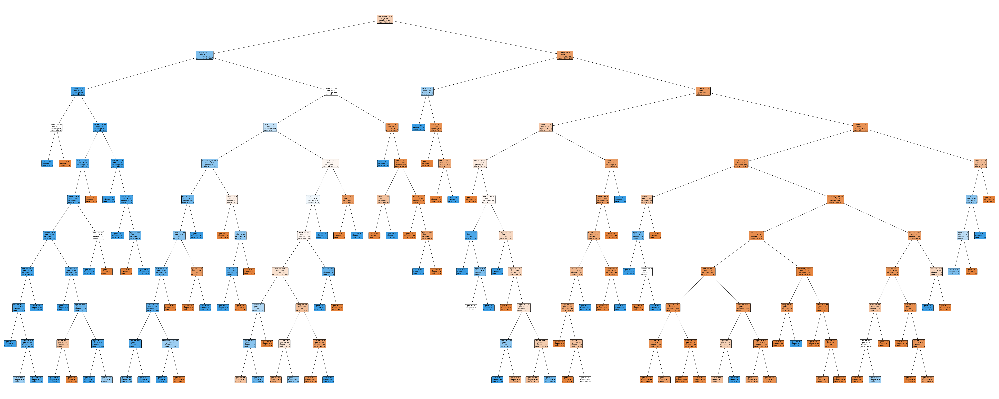

In [15]:
# Generate the tree from development dataset

graphviz_installed = False

if (graphviz_installed):
  export_graphviz(pruned_dev, out_file='titan_tree.dot', feature_names = X.columns,
                  rounded = True, proportion = False, precision = 2, filled = True)
  
  # Convert to png using system command
  #call(['dot', '-Tpng', 'titan_tree.dot', '-o', 'titan_tree.png', '-Gdpi=1200'])
  
else: 
  fig = plt.figure(figsize=(100,40))
  tree.plot_tree(pruned_dev,feature_names = X.columns, 
                     rounded = True, proportion = False, precision = 2, filled = True) #display tree
  fig.savefig('titan_tree.pdf')
  
#Image(filename = 'titan_tree.png', width=1200) #uncomment if using graphviz

Development Dataset Depth:  2


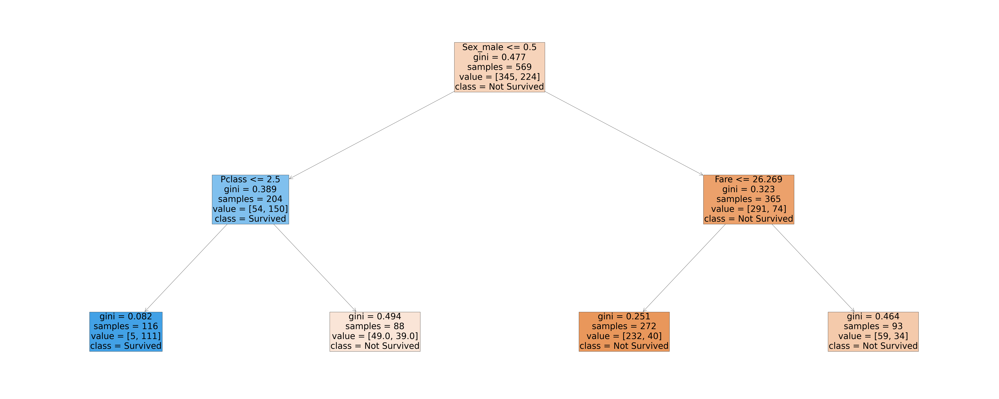

Development Dataset Depth:  3


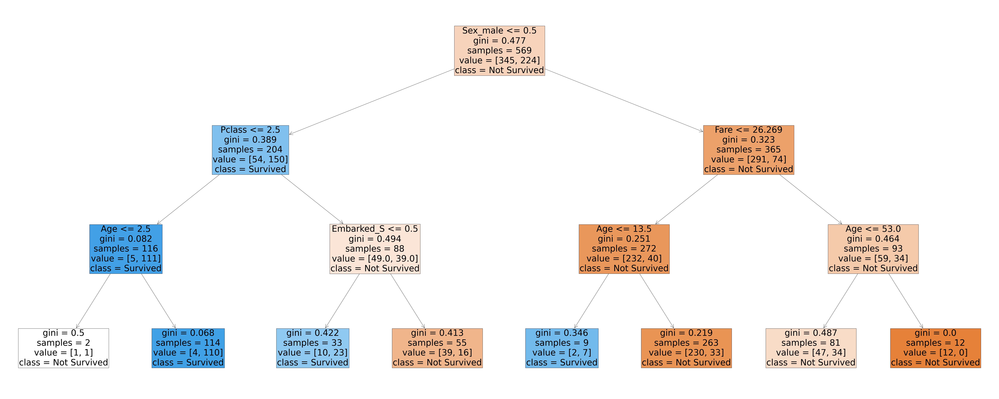

Development Dataset Depth:  4


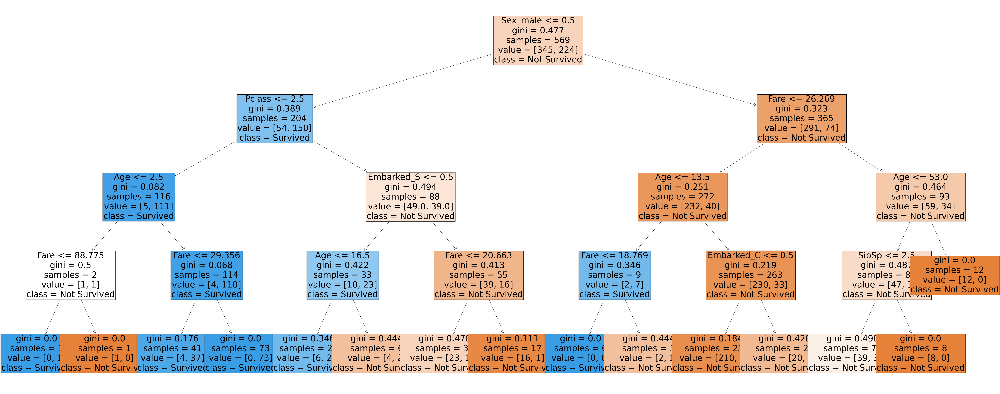

Development Dataset Depth:  5


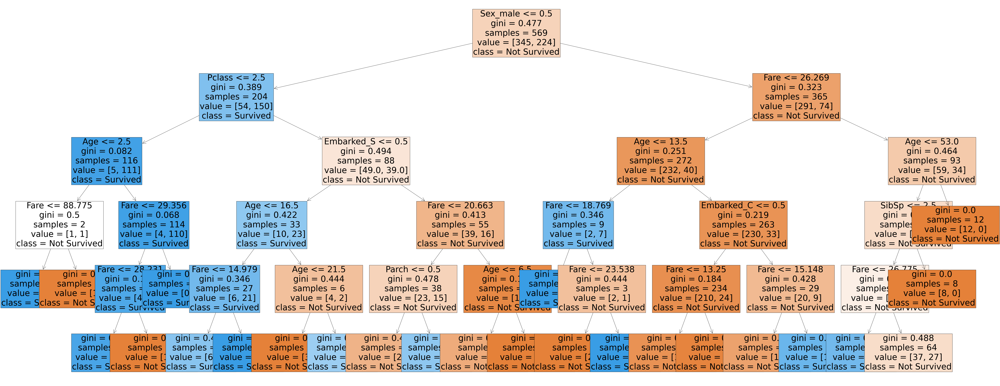

Development Dataset Depth:  6


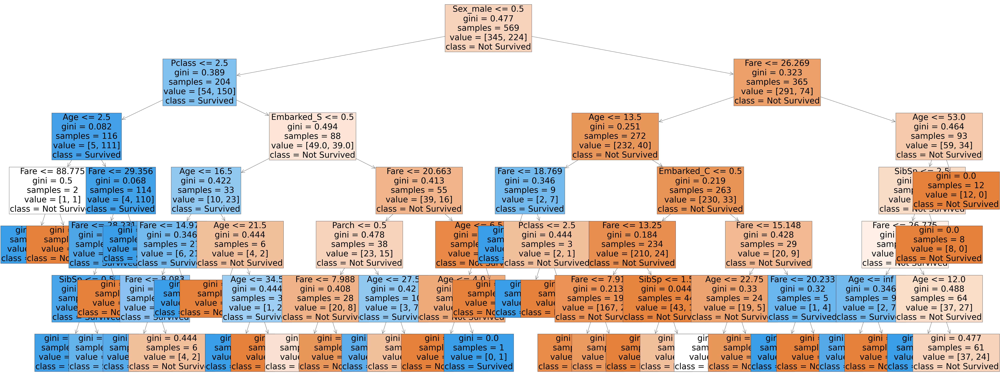

Development Dataset Depth:  7


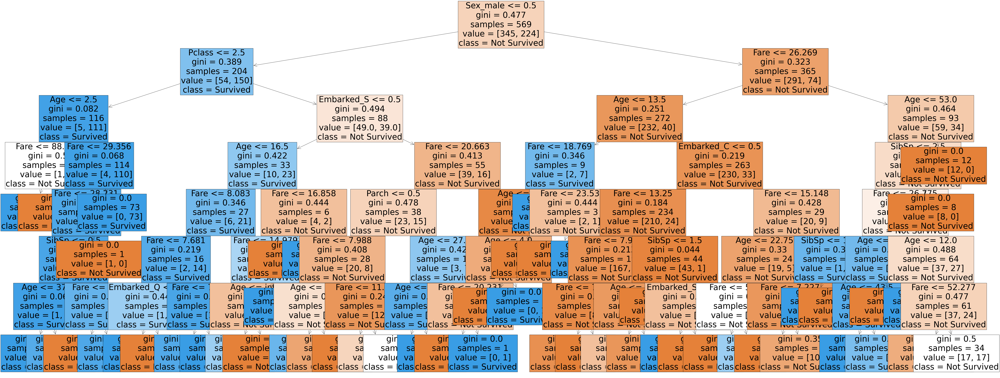

Development Dataset Depth:  8


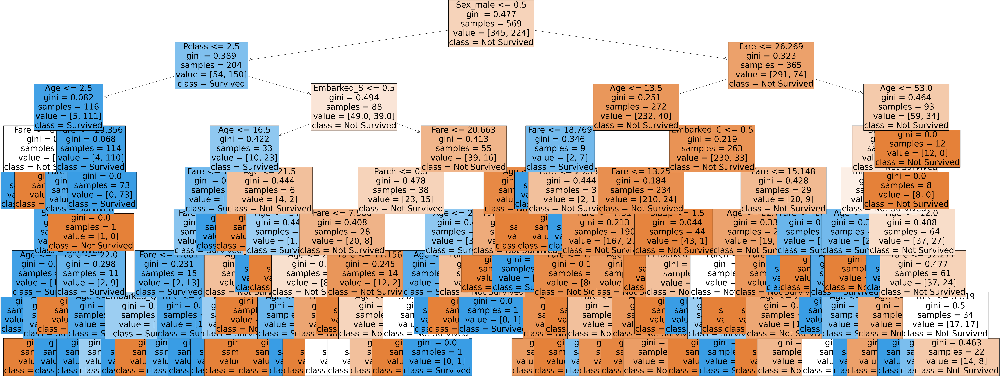

Development Dataset Depth:  9


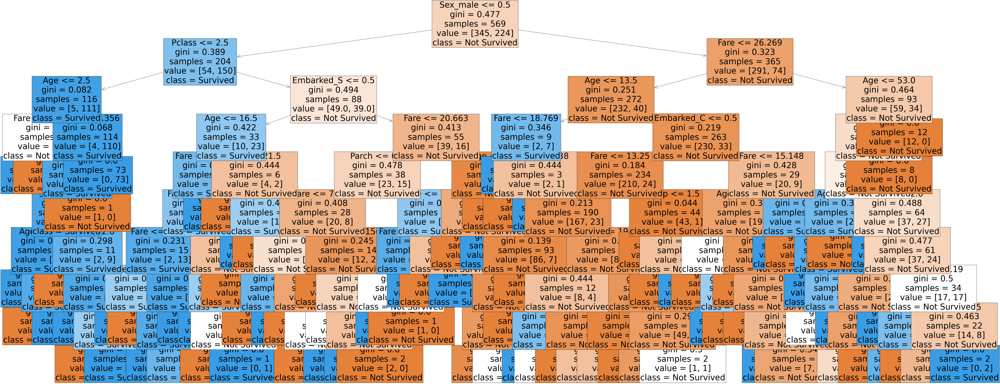

Development Dataset Depth:  10


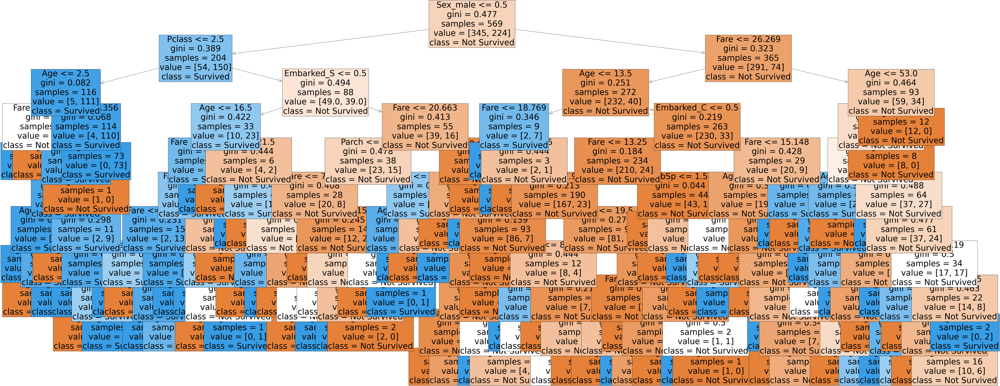

In [16]:
# Create Decision Tree for Development dataset from depth 2 - 10

for d in range(2,11):
  print('Development Dataset Depth: ', d)
  clf = DecisionTreeClassifier(max_depth=d, random_state=rseed)
  clf.fit(X_train, y_train)

  # Plot the tree
  plt.figure(figsize=(100,40))
  features = X_train.columns
  classes = ['Not Survived','Survived']
  tree.plot_tree(clf,feature_names=features,class_names=classes,filled=True,fontsize=48)
  plt.show()


Training Dataset Depth:  2


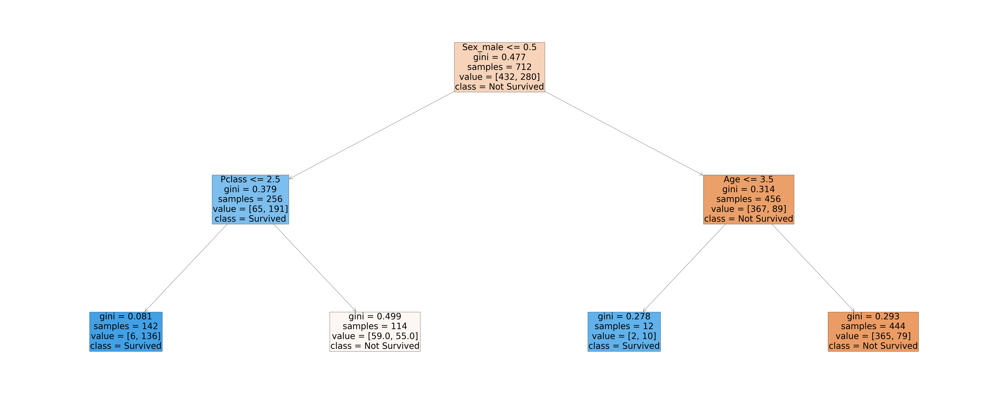

Training Dataset Depth:  3


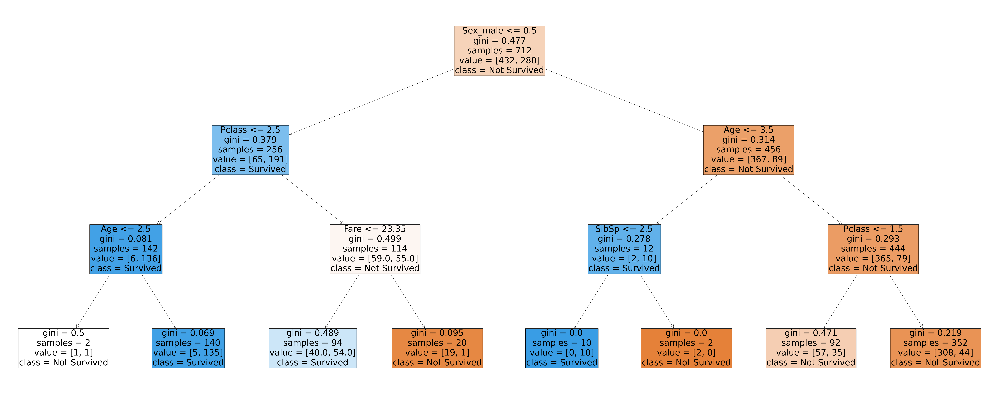

Training Dataset Depth:  4


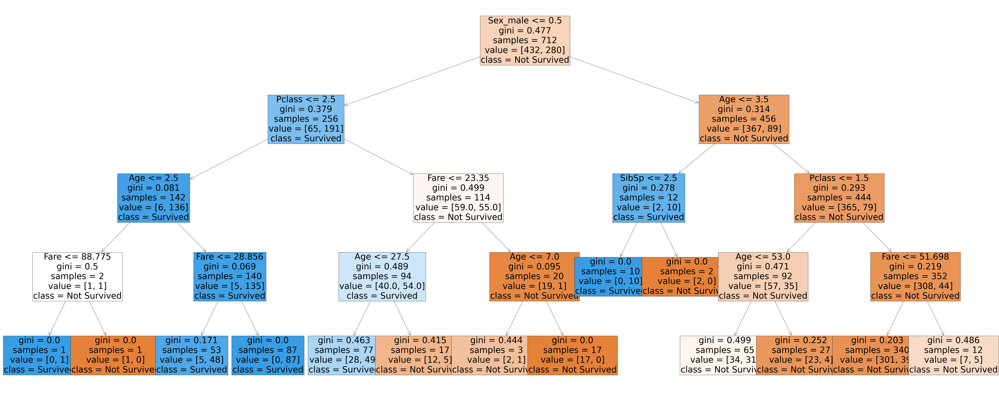

Training Dataset Depth:  5


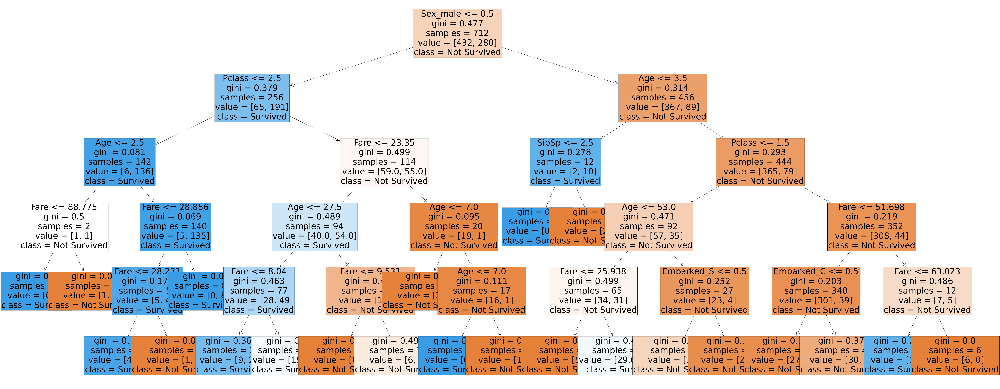

Training Dataset Depth:  6


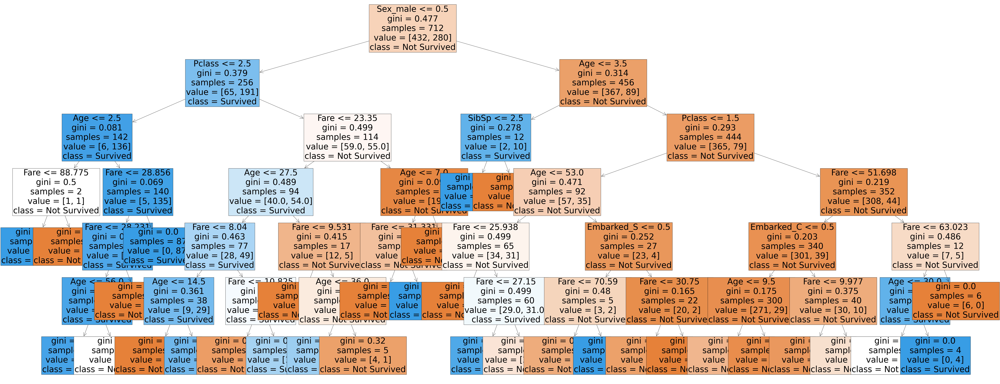

Training Dataset Depth:  7


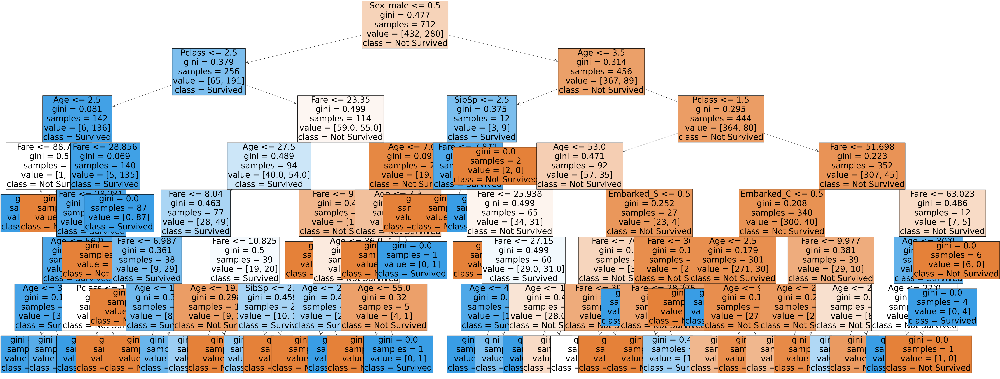

Training Dataset Depth:  8


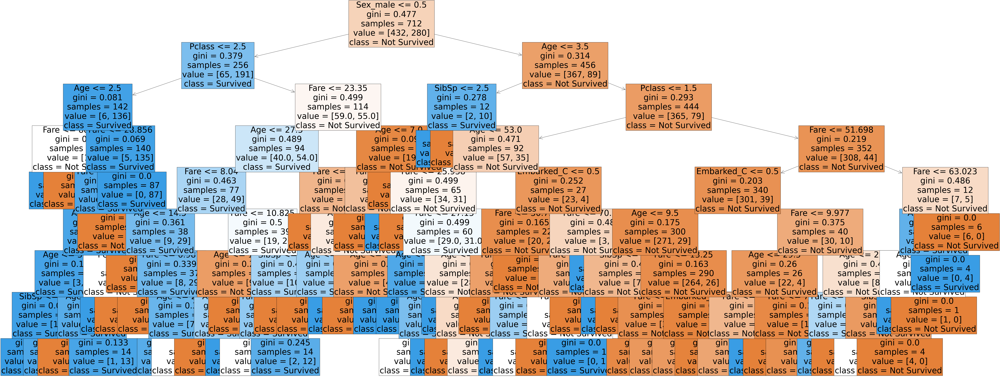

Training Dataset Depth:  9


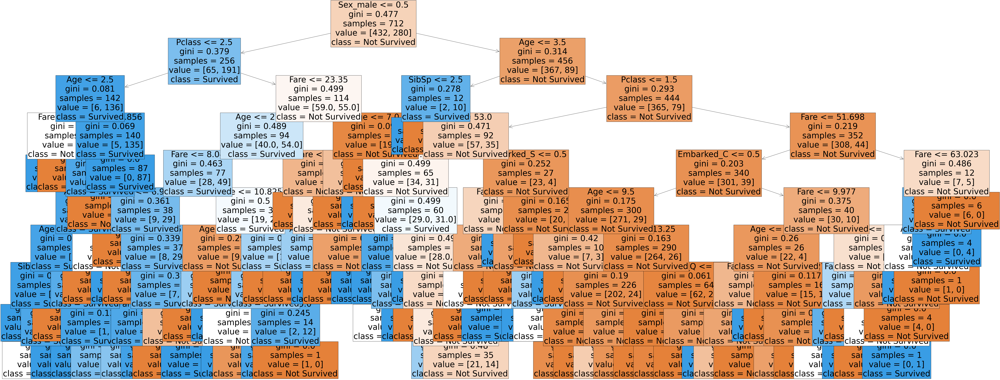

Training Dataset Depth:  10


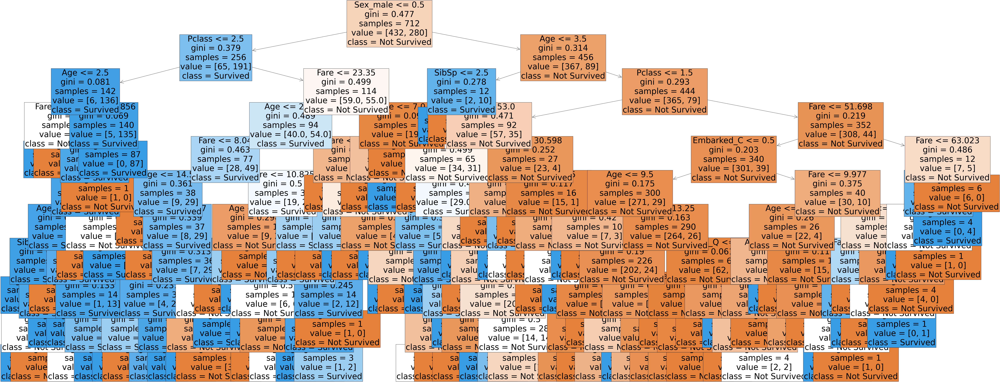

In [17]:
# Create Decision Tree for Training dataset from depth 2 - 10

for d in range(2,11):
  print('Training Dataset Depth: ', d)
  clf = DecisionTreeClassifier(max_depth=d, random_state=rseed)
  clf.fit(X_train_full, y_train_full)

  # Plot the tree
  plt.figure(figsize=(100,40))
  features = X_train_full.columns
  classes = ['Not Survived','Survived']
  tree.plot_tree(clf,feature_names=features,class_names=classes,filled=True,fontsize=48)
  plt.show()


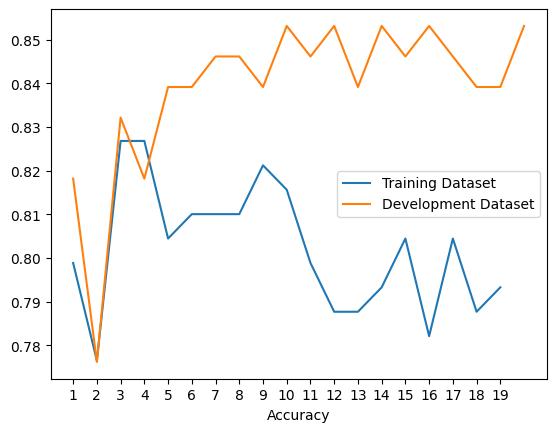

In [18]:
# Plot graph to compare development set and training set accurary according to the depth
fig, ax = plt.subplots()
line1, = ax.plot(pruned_depths_test, pruned_scores_test, label='Training Dataset')
#ax2.plot(pruned_depths_dev, pruned_scores_dev)
line2, = ax.plot(pruned_depths_dev, pruned_scores_dev, label='Development Dataset')
plt.xlabel("Max_depth values")
plt.xlabel("Accuracy")
ax.xaxis.set_ticks(pruned_depths_test)
ax.legend(handles=[line1, line2])
plt.show()

### Sample of the decision tree with survived based on Sex and Fare distribution by Development Dataset

In [19]:
# isolate only 2 features (sepal width and length) to allow visualisation on a 2d scale
X_sep = titanic_df.iloc[:,[5,6]].values
X_sep = X_sep.reshape(-1, 2)

#print(X_sep)

C:\Users\User\AppData\Local\Temp\ipykernel_345420\2953620881.py:25: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X_sep[idx, 0], X_sep[idx, 1], c=color, label=y[i],
C:\Users\User\AppData\Local\Temp\ipykernel_345420\2953620881.py:25: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X_sep[idx, 0], X_sep[idx, 1], c=color, label=y[i],
C:\Users\User\AppData\Local\Temp\ipykernel_345420\2953620881.py:25: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X_sep[idx, 0], X_sep[idx, 1], c=color, label=y[i],
C:\Users\User\AppData\Local\Temp\ipykernel_345420\2953620881.py:25: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X_sep[idx, 0], X_sep[idx, 1], c=color, label=y[i],
C:\Users\User\AppData\Local\Temp\ipykernel_345420\2953620881.py:25: UserWarning: No data for colormapping pr

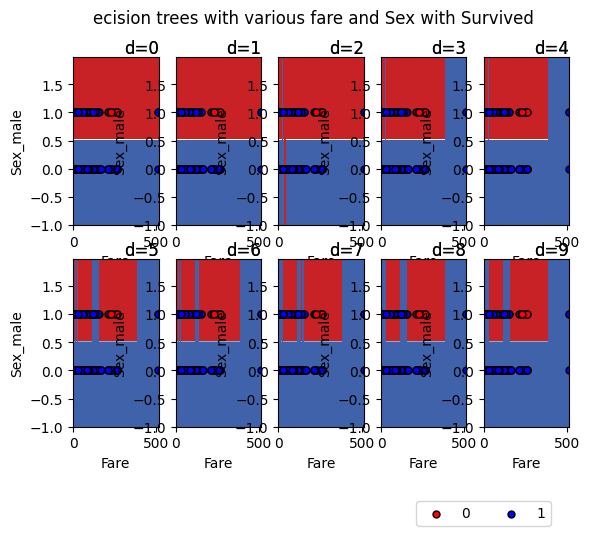

In [20]:
plt.suptitle("ecision trees with various fare and Sex with Survived")

# make subplots for each depth
for idx in range(0,10):  
  ax = plt.subplot(2,5, idx+1)

  x_min, x_max = X_sep[:, 0].min() - 1, X_sep[:, 0].max() + 1
  y_min, y_max = X_sep[:, 1].min() - 1, X_sep[:, 1].max() + 1
  
  xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02),
                       np.arange(y_min, y_max, 0.02))
  clf = DecisionTreeClassifier(max_depth=idx+1).fit(X_sep, y)
  Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
  Z = Z.reshape(xx.shape)
  cs = plt.contourf(xx, yy, Z, cmap=plt.cm.RdYlBu)

  plt.xlabel(titanic_df.columns[5])
  plt.ylabel(titanic_df.columns[6])

  ax.title = plt.title('d={}'.format(idx), loc='right', pad=-15)

  # Plot the training points
  for i, color in zip(range(2), "rb"):
      idx = np.where(y == i)
      plt.scatter(X_sep[idx, 0], X_sep[idx, 1], c=color, label=y[i], 
                  cmap=plt.cm.RdYlBu, edgecolor='black', s=25)
  
plt.legend(loc='upper center', ncol=3, bbox_to_anchor=(0, -0.40))
plt.show()

### Conclusion 
Comparing the Accuracy graph of training dataset adn development dataset, their accurarcy will be the closest at depth 3. After that the accuracy of the development seems increasing, but it will become overfit with comparing to the training dataset. 

By observing the sample of Decision surface with various fare and sex. We can observe that the major trend of Survival distribution between certain fare range and sex will be quite obvious at depth 3 (Death zone , fare lower than 350 and male). And after depth 3, some male below fare 350 will be predicted as survived for overfitting data, which is not optimal for the prediction.

So depth 3 should be used as the best decision tree depth level. The accuracy is around 0.832.